In [1]:
import pandas as pd
from dataprep.eda.distribution import plot
from dataprep.eda import create_report
import numpy as np
import warnings
warnings.filterwarnings('ignore',category=FutureWarning)

# Data Checking

## Objective
1. Focus on removing unusable data
2. Check typo
3. Generalize if possible

  0%|          | 0/1614 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
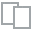
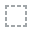
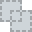
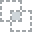
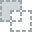
...
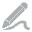
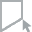
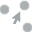
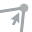
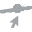

In [2]:
# Kalimantan Timur
path_file = 'data\KALTIM.xlsx'

df = pd.read_excel(path_file)
create_report(df)

In [3]:
df = df[['JAM DOWN', 'START DATE','KAB/KOTA', 'ROOTCAUSE', 'CUSTOMER', 'INCIDENT ID', 'TANGGAL PENGERJAAN', 'JAM UP', 'STATUS']]
df.columns = df.columns.str.lower().str.replace(' ', '_')
df.head(20)

,jam_down,start_date,kab/kota,rootcause,customer,incident_id,tanggal_pengerjaan,jam_up,status
0,<NA>,2023-10-01,Kota Samarinda,Kabel DW Rusak,PURNADI RAHMAN RAHMAN,23103100149,2023-10-01,15.37,✅
1,<NA>,2023-10-01,Kota Samarinda,Putus Kabel,SALWINDAH SALWINDAH,23103100240,2023-10-02,11.45,✅
2,<NA>,2023-10-01,Kota Samarinda,Core Crack/Bending,ENDANG SRIPENI(SMR),23103100234,2023-10-02,11.00,✅
3,<NA>,2023-10-02,Kota Samarinda,Putus Kabel,SUMALI,23103100327,2023-10-02,12.17,✅
4,<NA>,2023-10-02,Kota Samarinda,Putus Kabel,FARIS AKBAR,23103100332,2023-10-02,15.00,✅
5,<NA>,2023-10-02,Kota Samarinda,Bad Performance Perangkat,CLIMENTINA JOUNAS,23103100389,2023-10-02,15.01,✅
6,<NA>,2023-10-02,Kota Samarinda,Patchcore Rusak,ROHANI,23103100506,2023-10-03,11.01,✅
7,<NA>,2023-10-02,Kota Samarinda,<NA>,FITRI YANTI,23103100619,2023-10-03,11.54,✅
8,<NA>,2023-10-03,Kota Samarinda,Bad Performance Perangkat,RAGIL,23103100707,2023-10-03,13.03,✅
9,<NA>,2023-10-03,Kota Samarinda,Putus Kabel,MULAN ANDARESTA S,23103100632,2023-10-03,13.37,✅


### Clean Kota Kabupaten

In [4]:
unique_kab_kota_normal = list(df['kab/kota'].dropna().unique())
unique_kab_kota_capitalized = [item.title() for item in unique_kab_kota_normal]
set(unique_kab_kota_capitalized)

{'Bontang',
 'Kab. Kutai Kartanegara',
 'Kota Bontang',
 'Kota Samarinda',
 'Kutai Kartanegara',
 'Tenggarong'}

In [5]:
corrections = {
    'Kab. Kutai Kartanegara' : 'Kutai Kartanegara',
    'Bontang' : 'Kota Bontang',
    'Tenggarong' : 'Kutai Kartanegara',
    'Nan': None
}

### Clean Jam dan Tanggal
Cek row with wrong data format

In [6]:
df['jam_down'] = df['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':').str.replace('2023-','').str.replace('-',':').str.replace(' 00:00:00','')
df['jam_up'] = df['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

for entry in df['jam_up']:
    try:
        pd.to_datetime(entry, format='%H:%M')
    except ValueError:
        print(f"Problematic jam up entry: {entry}")

for entry in df['jam_down']:
    try:
        pd.to_datetime(entry, format='%H:%M')
    except ValueError:
        print(f"Problematic jam down entry: {entry}")

# df_cleaned.loc[df_cleaned['jam_up'] =='17:-05',['jam_up']] = '17:05'
# df_cleaned.loc[df_cleaned['jam_up'] =='1920',['jam_up']] = '19:20'
# df_cleaned.loc[df_cleaned['jam_down'] =='F',['jam_down']] = '00:00'
# df_cleaned.loc[df_cleaned['jam_down'] =='16/14',['jam_down']] = '16:14'


Problematic jam up entry: 1125
Problematic jam up entry: 1105
Problematic jam down entry: F
Problematic jam down entry: 16/14


## Clean Final

In [7]:
# Fungsi untuk membersihkan dan memformat ulang DataFrame
def clean_data(df):
    # Filter baris dengan ikon checklist hijau pada kolom 'STATUS'
    df_cleaned = df[df['status'] == '✅'].copy()

    # Mengisi nilai NaN pada 'jam_down' dengan "00.00" dan pada 'jam_up' dengan "20.00"
    df_cleaned['jam_down'].fillna("00.00", inplace=True)
    df_cleaned['jam_up'].fillna("20.00", inplace=True)

    # Memastikan semua entri pada 'kab/kota' adalah string dan memformatnya menjadi huruf kapital awal
    df_cleaned['kab/kota'] = df_cleaned['kab/kota'].astype(str).str.title().str.strip()

    return df_cleaned

# Menerapkan fungsi pembersihan pada DataFrame
df_cleaned = clean_data(df)

# Penyesuaian dan koreksi lebih lanjut
corrections = {
    'Kab. Kutai Kartanegara' : 'Kutai Kartanegara',
    'Bontang' : 'Kota Bontang',
    'Tenggarong' : 'Kutai Kartanegara',
    'Nan': None
}

df_cleaned['kab/kota'] = df_cleaned['kab/kota'].replace(corrections)
df_cleaned['kab/kota'] = df_cleaned['kab/kota'].str.strip()

# Mengganti nilai None dengan 'NaN' atau np.nan berdasarkan tipe data kolom
def replace_none_values(df):
    for col in df.columns:
        if df[col].dtype == 'object':  # untuk kolom string
            df[col] = df[col].replace({None: 'NaN'})
        elif np.issubdtype(df[col].dtype, np.number):  # untuk kolom numerik
            df[col] = df[col].replace({None: np.nan})
    return df

df_cleaned = replace_none_values(df_cleaned)

# Drop some false row
rows_to_drop = df_cleaned[df_cleaned['incident_id'] == 'soon']
df_cleaned = df_cleaned.drop(rows_to_drop.index)

# Memformat ulang jam_down dan jam_up
df_cleaned['jam_down'] = df_cleaned['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':')
df_cleaned['jam_up'] = df_cleaned['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

# Correction Time Values
df_cleaned.loc[df_cleaned['jam_down'] =='F',['jam_down']] = '00:00'
df_cleaned.loc[df_cleaned['jam_down'] =='16/14',['jam_down']] = '16:14'
df_cleaned.loc[df_cleaned['jam_up'] =='1125',['jam_up']] = '11:25'
df_cleaned.loc[df_cleaned['jam_up'] =='1105',['jam_up']] = '11:05'

# Mengonversi jam_down dan jam_up menjadi format waktu
df_cleaned['jam_down'] = pd.to_datetime(df_cleaned['jam_down'], format='%H:%M').dt.time
df_cleaned['jam_up'] = pd.to_datetime(df_cleaned['jam_up'], format='%H:%M').dt.time

# Menggabungkan tanggal dengan waktu
df_cleaned['time_down'] = pd.to_datetime(df_cleaned['start_date'].astype(str) + ' ' + df_cleaned['jam_down'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')
df_cleaned['time_up'] = pd.to_datetime(df_cleaned['tanggal_pengerjaan'].astype(str) + ' ' + df_cleaned['jam_up'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')

df_cleaned.drop(columns=['jam_down', 'jam_up','start_date', 'tanggal_pengerjaan', 'status'], inplace=True)   
df_cleaned['customer-kota'] = df_cleaned['customer'].astype(str) + ' ' + df_cleaned['kab/kota'].astype(str)
df_cleaned

,kab/kota,rootcause,customer,incident_id,time_down,time_up,customer-kota
0,Kota Samarinda,Kabel DW Rusak,PURNADI RAHMAN RAHMAN,23103100149,2023-10-01 00:00:00,2023-10-01 15:37:00,PURNADI RAHMAN RAHMAN Kota Samarinda
1,Kota Samarinda,Putus Kabel,SALWINDAH SALWINDAH,23103100240,2023-10-01 00:00:00,2023-10-02 11:45:00,SALWINDAH SALWINDAH Kota Samarinda
2,Kota Samarinda,Core Crack/Bending,ENDANG SRIPENI(SMR),23103100234,2023-10-01 00:00:00,2023-10-02 11:00:00,ENDANG SRIPENI(SMR) Kota Samarinda
3,Kota Samarinda,Putus Kabel,SUMALI,23103100327,2023-10-02 00:00:00,2023-10-02 12:17:00,SUMALI Kota Samarinda
4,Kota Samarinda,Putus Kabel,FARIS AKBAR,23103100332,2023-10-02 00:00:00,2023-10-02 15:00:00,FARIS AKBAR Kota Samarinda
...,...,...,...,...,...,...,...
406,Kota Samarinda,NaN,INDRIANI,23113108954,2023-11-30 23:09:00,2023-12-01 17:12:00,INDRIANI Kota Samarinda
407,Kota Samarinda,Patchcore Rusak,MITA PURNAMASARI,23123100042,2023-11-30 10:32:00,2023-12-01 14:51:00,MITA PURNAMASARI Kota Samarinda
408,Kota Samarinda,NaN,RAHMADI KURNAIN,23123100074,2023-11-30 11:20:00,2023-12-01 14:36:00,RAHMADI KURNAIN Kota Samarinda
409,Kota Samarinda,Putus Kabel,REVI OKTASARI,23123100134,2023-11-30 15:17:00,2023-12-01 18:20:00,REVI OKTASARI Kota Samarinda


  0%|          | 0/674 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
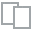
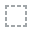
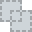
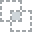
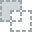
...
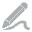
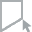
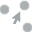
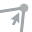
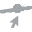

In [8]:
create_report(df_cleaned)

In [9]:
df_cleaned.to_excel('data/KALTIM_clean.xlsx')